# <p style="text-align:center;"><span style="font-size:48px;"><span style="color:#907FFB;"><span style="font-family:cursive;"> Trash Detection</span> </span>  </span></p>

![image](https://as2.ftcdn.net/v2/jpg/01/75/30/43/1000_F_175304383_t2k1KguGHntdyHQbtWLo4qOBKlW2W4xF.jpg)

<a id="contents_tabel"></a>
<div style="border-radius:10px; padding: 15px; background-color: #FFF545; font-size:115%; text-align:left">

<h3 align="left"><font color=black>Table of Contents :</font></h3>

* [Phase 1 : Import & Install Libraries](#import)    
* [Phase 2 : About Dataset](#about)
    - [Phase 2.1 : Import Dataset](#importdata)
    - [Phase 2.2 : About Shape and Number](#features)
* [Phase 3 : EDA ( Exploratory data analysis ) On Dataset](#eda)
* [Phase 4 : Data Preprocessing](#prep)
    - [Phase 4.1 : Increase Data Quality](#inc)
    - [Phase 4.2 : Train, Test, Validation Split](#ttsplit)
    - [Phase 4.3 : Data Augmentation](#aug)
* [Phase 5 : Prepare Network](#net)    
* [Phase 6 : Prepare Train Objects](#trainobj)    
* [Phase 7 : Train](#train)    
* [Phase 8 : Evaluate](#eval)
* [Phase 9 : Test](#test)

<a id="import"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 1 : Import & Install Libraries</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [1]:
# Main Works
import os
import tensorflow as tf
import numpy as np
import pandas as pd
import random

# EDA
import cv2
import glob
from sklearn.utils.class_weight import compute_class_weight

# Visualization
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from tensorflow.keras.utils import plot_model

# Preprocessing
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_datasets as tfds
from kaggle_datasets import KaggleDatasets

# Model Structured
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense

# Training Objects
from tensorflow.keras.callbacks import EarlyStopping

# Train
from tensorflow.keras.callbacks import ModelCheckpoint

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


<a id="importdata"></a>
## <p style="background-color:#23ff16; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:left; border-radius:200px 200px;">Phase 2.1 : Import Dataset</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [2]:
dataset = {}
for class_name in glob.glob('/kaggle/input/trash-type-detection/trash_images/*'):
        dataset[class_name.split('/')[-1]] = glob.glob(class_name + '/*')


In [6]:
dataset.keys()

dict_keys(['metal', 'glass', 'paper', 'trash', 'cardboard', 'plastic'])

<a id="features"></a>
## <p style="background-color:#23ff16; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:left; border-radius:200px 200px;">Phase 2.2 : About Shape and Number</p>

⬆️ [Tabel of Contents](#contents_tabel)

[410, 501, 594, 137, 403, 482]
dict_keys(['metal', 'glass', 'paper', 'trash', 'cardboard', 'plastic'])


<BarContainer object of 6 artists>

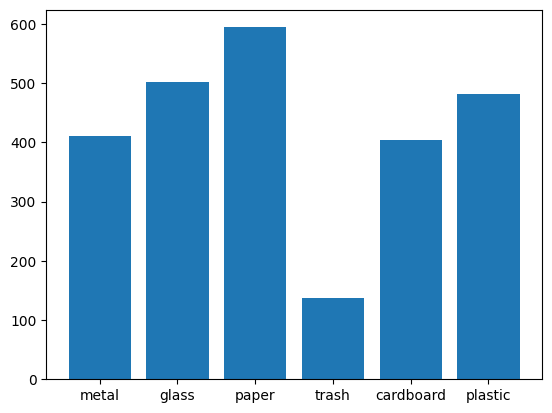

In [3]:
x = dataset.keys()
y = [len(number) for number in dataset.values()]
print(y)
print(x)

plt.bar(x, y)

In [5]:
def get_dims(file):
    '''Returns dimenstions for an image'''
    image = cv2.imread(file)    
    h, w, d = image.shape
    return h, w, d

In [6]:
df = pd.DataFrame(columns=['Height',
                           'Width',
                           'Channels',
                           'Class'])

for class_name in dataset.keys():
    for path in dataset[class_name]:
        h, w, d = get_dims(path)
        df.loc[len(df)] = [h, w, d, class_name]

df

,Height,Width,Channels,Class
0,384,512,3,metal
1,384,512,3,metal
2,384,512,3,metal
3,384,512,3,metal
4,384,512,3,metal
...,...,...,...,...
2522,384,512,3,plastic
2523,384,512,3,plastic
2524,384,512,3,plastic
2525,384,512,3,plastic


In [7]:
fig = px.scatter_3d(df, x='Height', y='Width', z='Channels', color='Class', symbol='Class',
                    labels={'Height':'Height', 'Width':'Width', 'Channels':'Channels'},
                    title='3D Scatter plot of Image Dimensions by Class')

fig.show()

<a id="eda"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 3 : EDA ( Exploratory data analysis ) On Dataset</p>

⬆️ [Tabel of Contents](#contents_tabel)

<p style="background-color:#efeeee; padding: 15px; font-family:cursive; color:black; font-size:200%; text-align:center; border-radius:200px 200px;">Show some data</p>

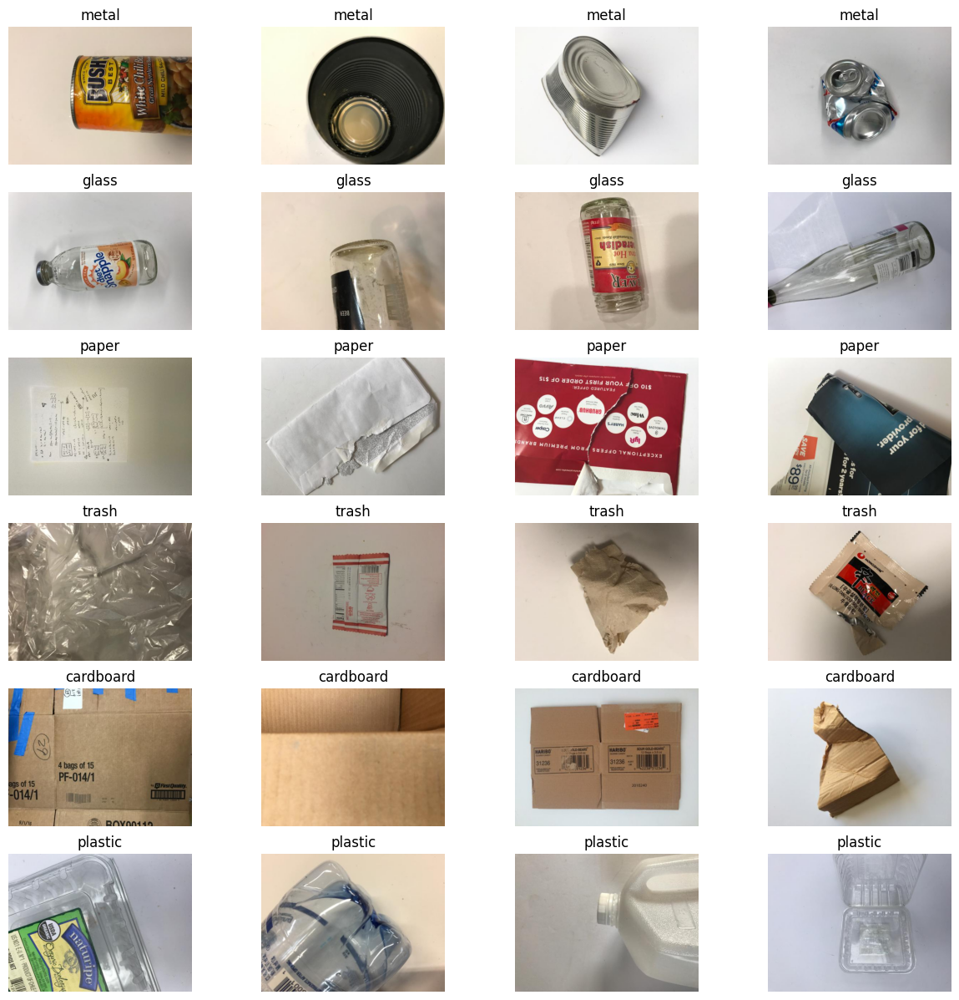

In [28]:
count = 0
plt.figure(figsize=(15, 15))
for class_type in dataset.keys():    
    for path in dataset[class_type]:                
        sp = plt.subplot(6, 4, count + 1, )
        sp.axis('Off')
        sp.set_title(class_type)        
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        count += 1
        if count % 4 == 0:            
            break
plt.show()

<p style="background-color:#efeeee; padding: 15px; font-family:cursive; color:black; font-size:200%; text-align:center; border-radius:200px 200px;">Check contrast</p>

In [31]:
def compute_mean_histogram(image_paths):
    histograms = {'red': [], 'green': [], 'blue': []}
    for image_path in image_paths:
        image = cv2.imread(image_path)  # Load image in color mode
        for i, color in enumerate(('blue', 'green', 'red')):
            hist = cv2.calcHist([image], [i], None, [256], [0, 256])
            histograms[color].append(hist)
    mean_histograms = {color: np.mean(hists, axis=0) for color, hists in histograms.items()}
    return mean_histograms

mean_histograms_per_class = {}
for class_label, image_paths in dataset.items():
    mean_histograms_per_class[class_label] = compute_mean_histogram(image_paths)

In [32]:
# Plotting
fig = go.Figure()
for class_label, mean_histograms in mean_histograms_per_class.items():
    for color, mean_histogram in mean_histograms.items():
        fig.add_trace(go.Scatter(x=np.arange(256), y=mean_histogram.flatten(), mode='lines', name=f'{class_label} - {color}'))

fig.update_layout(
    title='Mean Histograms per Class per Channel',
    xaxis_title='Pixel Value',
    yaxis_title='Frequency',
    legend_title='Class - Channel'
)
fig.show()

<p style="background-color:#efeeee; padding: 15px; font-family:cursive; color:black; font-size:200%; text-align:center; border-radius:200px 200px;">Check Standard Deviation</p>

In [38]:
def compute_avg_std(image_paths):
    stds = {'red': [], 'green': [], 'blue': []}
    for image_path in image_paths:
        image = cv2.imread(image_path)  # Load image in color mode
        for i, color in enumerate(('blue', 'green', 'red')):
            std = np.std(image[:,:,i])
            stds[color].append(std)
    avg_stds = {color: np.mean(values) for color, values in stds.items()}
    return avg_stds

avg_stds_per_class = {}
for class_label, image_paths in dataset.items():
    avg_stds_per_class[class_label] = compute_avg_std(image_paths)

In [39]:
# Plotting
categories = list(avg_stds_per_class.keys())
fig = go.Figure()
for color in ['red', 'green', 'blue']:
    values = [avg_stds_per_class[class_label][color] for class_label in categories]
    fig.add_trace(go.Bar(x=categories, y=values, name=f'{color} channel'))

fig.update_layout(
    title='Average Standard Deviation of Pixel Values per Class per Channel',
    xaxis_title='Class',
    yaxis_title='Average Standard Deviation',
    legend_title='Channel'
)
fig.show()

<p style="background-color:#efeeee; padding: 15px; font-family:cursive; color:black; font-size:200%; text-align:center; border-radius:200px 200px;">Check Noise Level</p>

In [8]:
def estimate_noise(image_paths):
    noise_levels = []
    for image_path in image_paths:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load image in grayscale mode
        laplacian = cv2.Laplacian(image, cv2.CV_64F)
        std_dev = np.std(laplacian)
        noise_levels.append(std_dev)
    mean_noise_level = np.mean(noise_levels)
    return mean_noise_level

mean_noise_levels = {}
for class_label, image_paths in dataset.items():
    mean_noise_levels[class_label] = estimate_noise(image_paths)

In [9]:
# Plotting
fig = go.Figure()
class_labels = list(mean_noise_levels.keys())
noise_levels = list(mean_noise_levels.values())
fig.add_trace(go.Bar(x=class_labels, y=noise_levels))
fig.update_layout(
    title='Estimated Noise Levels per Class',
    xaxis_title='Class',
    yaxis_title='Estimated Noise Level',
    legend_title='Class'
)
fig.show()

<p style="background-color:#efeeee; padding: 15px; font-family:cursive; color:black; font-size:200%; text-align:center; border-radius:200px 200px;">Spectral Analysis</p>

In [3]:
def compute_mean_spectrum(image_paths):
    spectrum_sum = np.zeros((384, 512))  # Assumes images are 256x256 pixels
    num_images = len(image_paths)
    for image_path in image_paths:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load image in grayscale mode
        f = np.fft.fft2(image)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = np.log(np.abs(fshift) + 1)
        spectrum_sum += magnitude_spectrum
    mean_spectrum = spectrum_sum / num_images
    return mean_spectrum

mean_spectrums = {}
for class_label, image_paths in dataset.items():
    mean_spectrums[class_label] = compute_mean_spectrum(image_paths)

In [23]:
# Plotting
fig = go.Figure()

# Add one surface trace for each class
for class_label, mean_spectrum in mean_spectrums.items():
    fig.add_trace(go.Surface(z=mean_spectrum, name=class_label, visible=False))

# Make the first class visible
fig.data[0].visible = True

# Create buttons for dropdown menu
buttons = [dict(label=class_label,
                method="update",
                args=[{"visible": [class_label==label for label in mean_spectrums.keys()]}])
           for class_label in mean_spectrums.keys()]

# Add dropdown menu
fig.update_layout(
    updatemenus=[dict(buttons=buttons, direction="down", showactive=True, x=1.05, xanchor="left", y=1.15, yanchor="top")]
)

fig.update_layout(
    title='Mean Spectrum per Class',
    scene=dict(
        xaxis_title='Frequency X',
        yaxis_title='Frequency Y',
        zaxis_title='Magnitude'
    )
)

fig.show()


<a id="prep"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 4 : Data Preprocessing</p>

⬆️ [Tabel of Contents](#contents_tabel)

<a id="inc"></a>
## <p style="background-color:#23ff16; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:left; border-radius:200px 200px;">Phase 4.1 : Increase Data Quality</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [24]:
def save_he_img(image_paths):          
    for image_path in image_paths:
        # Load image 
        image = cv2.imread(image_path)  
        
        # Split RGB
        b,g,r = cv2.split(image)
        
        # Apply Histogram Equlization
        equ_b = cv2.equalizeHist(b)
        equ_g = cv2.equalizeHist(g)
        equ_r = cv2.equalizeHist(r)
        equ = cv2.merge((equ_b, equ_g, equ_r))        
        cv2.imwrite(image_path.rsplit('/', 1)[0] + '/' +image_path.split('/')[-1].split('.')[0] + 'he.jpg', equ)

for class_label, image_paths in dataset.items():
    save_he_img(image_paths)

In [ ]:
def save_clahe_img(image_paths):          
    for image_path in image_paths:
        # Load image 
        image = cv2.imread(image_path)  
        
        # RGB 2 Lab
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        
        # Split Lab
        lab_planes = cv2.split(lab)
        
        # Apply Histogram Equlization
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        lab_planes[0] = clahe.apply(lab_planes[0])
        lab = cv2.merge(lab_planes)
        cla = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
        cv2.imwrite(image_path.rsplit('/', 1)[0] + '/' +image_path.split('/')[-1].split('.')[0] + 'clahe.jpg', cla)

for class_label, image_paths in dataset.items():
    save_clahe_img(image_paths)

<a id="ttsplit"></a>
## <p style="background-color:#23ff16; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:left; border-radius:200px 200px;">Phase 4.2 : Train, Test, Validation Split</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [13]:
directory_path = '/kaggle/input/trash-type-detection/trash_images'
image_size = (384, 512)
batch_size = 16  

# Create the training and validation datasets
train_ds = tf.keras.utils.image_dataset_from_directory(
    directory=directory_path,
    validation_split=0.2,
    subset="training",
    seed=1337,
    image_size=image_size,
    batch_size=batch_size
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    directory=directory_path,
    validation_split=0.2,
    subset="validation",
    seed=1337,
    image_size=image_size,
    batch_size=batch_size
)


Found 2527 files belonging to 6 classes.
Using 2022 files for training.
Found 2527 files belonging to 6 classes.
Using 505 files for validation.


In [14]:
# Get the number of batches in the validation dataset
val_batches = tf.data.experimental.cardinality(val_ds)

# Split the validation dataset into validation and test datasets
test_ds = val_ds.take(val_batches // 2)
val_ds = val_ds.skip(val_batches // 2)


<a id="aug"></a>
## <p style="background-color:#23ff16; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:left; border-radius:200px 200px;">Phase 4.3 : Data Augmentation</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [15]:
data_augmentation = tf.keras.Sequential([    
    tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.1),    
])

In [16]:
# Apply other augmentations only to the training dataset
augmented_train_ds = train_ds.map(
    lambda x, y: (data_augmentation(x, training=True), y)
)

In [17]:
def one_hot_encode(image, label):
    return image, tf.one_hot(label, depth=6)  # Assuming 6 classes

train_ds_one_hot = augmented_train_ds.map(one_hot_encode)
val_ds_one_hot   = val_ds.map(one_hot_encode)
test_ds_one_hot  = test_ds.map(one_hot_encode)

<a id="net"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 5 : Prepare Network</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [23]:
model = tf.keras.models.Sequential([   
    # Rescale
    tf.keras.layers.experimental.preprocessing.Rescaling(1./255, input_shape=(384, 512, 3)),
    
    # Convolutional block 1
    tf.keras.layers.Conv2D(128, (3, 3), activation='elu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.BatchNormalization(synchronized=True),
    tf.keras.layers.Dropout(0.2),
    
    # Convolutional block 2
    tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), activation='elu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.BatchNormalization(synchronized=True),
    tf.keras.layers.Dropout(0.2),
    
    # Convolutional block 3
    tf.keras.layers.Conv2D(32, (3, 3), dilation_rate=(2, 2), activation='elu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.BatchNormalization(synchronized=True),
    tf.keras.layers.Dropout(0.2),
    
    # Convolutional block 4
    tf.keras.layers.Conv2D(32, (3, 3), activation='elu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.BatchNormalization(synchronized=True),
    tf.keras.layers.Dropout(0.2),
    
    # Convolutional block 5
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.BatchNormalization(synchronized=True),
    tf.keras.layers.Dropout(0.2),
    
    # Flatten and fully-connected layers
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='elu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(64, activation='elu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(6, activation='softmax')  
])


In [24]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_2 (Rescaling)     (None, 384, 512, 3)       0         
                                                                 
 conv2d_10 (Conv2D)          (None, 382, 510, 128)     3584      
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 191, 255, 128)    0         
 g2D)                                                            
                                                                 
 batch_normalization_10 (Bat  (None, 191, 255, 128)    512       
 chNormalization)                                                
                                                                 
 dropout_8 (Dropout)         (None, 191, 255, 128)     0         
                                                                 
 conv2d_11 (Conv2D)          (None, 94, 126, 64)      

<a id="trainobj"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 6 : Prepare Train Objects</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [26]:
OPTIMIZER  = tf.keras.optimizers.SGD(learning_rate=0.01,
                                     momentum=0.9,
                                     nesterov=True,
                                     weight_decay=0.01)
LOSS       = tf.keras.losses.CategoricalCrossentropy()
METRICS    = [tf.keras.metrics.CategoricalAccuracy(),
              tf.keras.metrics.Recall(name='recall'),
              tf.keras.metrics.Precision(name='precision')]

CHECKPOINT = ModelCheckpoint('trash_classification.h5',
                             monitor='val_categorical_accuracy',
                             mode='max',
                             save_best_only=True)

model.compile(optimizer=OPTIMIZER,
              loss=LOSS,
              metrics=METRICS)

<a id="train"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 7 : Train</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [27]:
history = model.fit(train_ds_one_hot,
                    callbacks=[CHECKPOINT],
                    epochs=100,
                    validation_data=val_ds_one_hot)

Epoch 1/100


2023-10-21 18:44:46.301130: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_4/dropout_8/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


127/127 [==============================] - 72s 534ms/step - loss: 1.6827 - categorical_accuracy: 0.3442 - recall: 0.1222 - precision: 0.4920 - val_loss: 1.7461 - val_categorical_accuracy: 0.3133 - val_recall: 0.0161 - val_precision: 0.1250
Epoch 2/100
127/127 [==============================] - 74s 577ms/step - loss: 1.4563 - categorical_accuracy: 0.4065 - recall: 0.1701 - precision: 0.6503 - val_loss: 2.0895 - val_categorical_accuracy: 0.2129 - val_recall: 0.1807 - val_precision: 0.2616
Epoch 3/100
127/127 [==============================] - 70s 550ms/step - loss: 1.4121 - categorical_accuracy: 0.4550 - recall: 0.2191 - precision: 0.6439 - val_loss: 1.6034 - val_categorical_accuracy: 0.4137 - val_recall: 0.1365 - val_precision: 0.6667
Epoch 4/100
127/127 [==============================] - 73s 574ms/step - loss: 1.3752 - categorical_accuracy: 0.4629 - recall: 0.2344 - precision: 0.6371 - val_loss: 1.5593 - val_categorical_accuracy: 0.3614 - val_recall: 0.2088 - val_precision: 0.4370
Epoc

<a id="eval"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 8 : Evaluate</p>

⬆️ [Tabel of Contents](#contents_tabel)

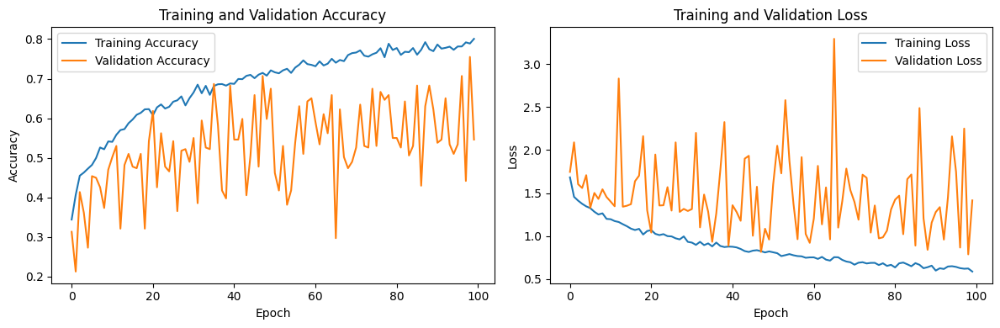

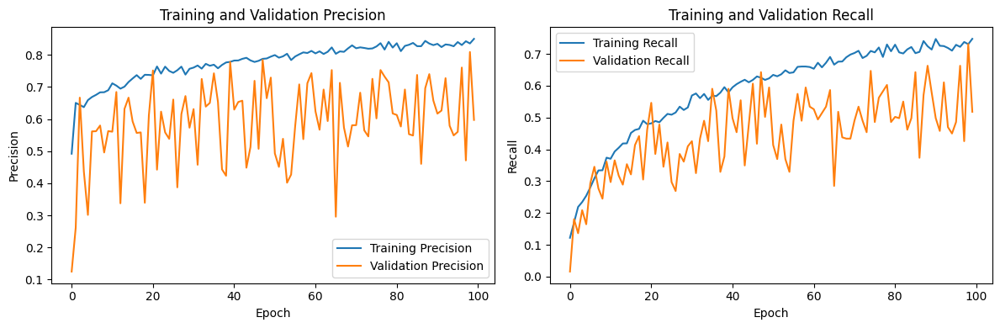

In [28]:
# Access the accuracy and loss values over epochs
accuracy = model.history.history['categorical_accuracy']  # Replace 'accuracy' with 'acc' for older versions of Keras
val_accuracy = model.history.history['val_categorical_accuracy']  # Replace 'val_accuracy' with 'val_acc' for older versions of Keras
loss = model.history.history['loss']
val_loss = model.history.history['val_loss']

# If you have precision and recall metrics, you can access them as well
precision = model.history.history['precision']
val_precision = model.history.history['val_precision']
recall = model.history.history['recall']
val_recall = model.history.history['val_recall']

# Create subplots for accuracy and loss
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(accuracy, label='Training Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

plt.tight_layout()

# If precision and recall metrics are available, create additional plots
if 'precision' in model.history.history:
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(precision, label='Training Precision')
    plt.plot(val_precision, label='Validation Precision')
    plt.xlabel('Epoch')
    plt.ylabel('Precision')
    plt.title('Training and Validation Precision')
    plt.legend()

if 'recall' in model.history.history:
    plt.subplot(1, 2, 2)
    plt.plot(recall, label='Training Recall')
    plt.plot(val_recall, label='Validation Recall')
    plt.xlabel('Epoch')
    plt.ylabel('Recall')
    plt.title('Training and Validation Recall')
    plt.legend()

plt.tight_layout()
plt.show()

<a id="test"></a>
# <p style="background-color:#afeff9; padding: 15px; font-family:cursive; color:black; font-size:100%; text-align:center; border-radius:200px 200px;">Phase 9 : Test</p>

⬆️ [Tabel of Contents](#contents_tabel)

In [30]:
model_new = tf.keras.models.load_model('/kaggle/working/trash_classification.h5')

In [31]:
model_new.evaluate(test_ds_one_hot)

16/16 [==============================] - 1s 50ms/step - loss: 0.8830 - categorical_accuracy: 0.6992 - recall: 0.6680 - precision: 0.7467


[0.8829633593559265, 0.69921875, 0.66796875, 0.7467249035835266]